Load Visium
----
Load visum data from spaceranger output.

Visium images information: 

- 1 visium slide, 4 images:
    - A: AD temporal cortex
    - B: AD visual cortex
    - C: Control temporal Cortex
    - D Control visual cortex
- brightfield images from H&E staining

reference:refdata-gex-GRCh38-2020-A

Spaceranger version: spaceranger-2.1.1


## Dependecy notebooks

Requires spaceranger output.

Spaceranger run with: `spaceranger count --id=V1_AD1_human_$AREA --transcriptome=$PATH_TO_REFERENCE_GTF --fastqs=$PATH_TO_FASTQ_FILES --image="{$AREA}{$PATH_TO_TIF}"/$TIF_NAME --slide V11D13-028 --area "{$AREA}1" --sample CACTACGA_ATCAGTCT_$AREA` for area (A1, B1, C1, D1)

## Import packages

If you want modules to be automatically reloaded when you call them, use `autoreload`:

In [428]:
%load_ext autoreload
%autoreload2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


UsageError: Line magic function `%autoreload2` not found.


Import packages

In [1]:
# import standard packages
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import os
import sys
import anndata as ad

# import single-cell packages
import scanpy as sc
import squidpy as sq
#import scanorama

from pathlib import Path
from scipy.stats import median_abs_deviation

# set verbosity levels
sc.settings.verbosity = 2

## Print package versions for reproducibility

If you want to exactly reproduce the results shown here, please make sure that your package versions match what is printed below. 

In [430]:
#sc.logging.print_versions()

## Set up paths

Define global paths.

In [431]:
sys.path.insert(0, "../")  # this depends on the notebook depth and must be adapted per notebook

VISIUM_DATA = '/lustre/groups/ml01/projects/2023_ad_jaekel/human_visium/'
from paths import DATA_DIR, RESULTS_DIR, FIG_DIR
from colors import AREA_COLOR, CELL_TYPES_COLOR, CONDITION_COLOR

FIG_DIR = str(Path(FIG_DIR, 'visium'))

sc.settings.figdir = str(FIG_DIR)

Set up the paths to save figures.

In [432]:
sc.settings.figdir = str(FIG_DIR)

## Define utility functions

In [433]:
from utils.qc import plot_qc_joint, get_qc_metrics, statistical_test_boxplot

## Set global parameters

Set some plotting parameters.

In [434]:
plt.rcParams['figure.dpi'] = 90
plt.rcParams['savefig.dpi'] = 300 # If 'figure', uses the figure's dpi value.
SMALL_SIZE = 17
MEDIUM_SIZE = 19
BIGGER_SIZE = 21
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

In [435]:
IMAGES = ['A1', 'B1', 'C1', 'D1']

In [436]:
cond_area_dict = {
    'A1' : 'AD_TC',
    'B1' : 'AD_VC',
    'C1' : 'Ctrl_TC',
    'D1' : 'Ctrl_VC'
}
area_dict = {
    'A1' : 'TC',
    'B1' : 'VC',
    'C1' : 'TC',
    'D1' : 'VC'
}
condition_dict = {
    'A1' : 'AD',
    'B1' : 'AD',
    'C1' : 'Control',
    'D1' : 'Control'
}

If there are other global parameters for this analysis, put them here as well. 

## Load visium data

In [437]:
adata = sc.read_h5ad(f'{VISIUM_DATA}/adata/adata.h5ad')
adata

AnnData object with n_obs × n_vars = 17169 × 36601
    obs: 'in_tissue', 'array_row', 'array_col', 'image'
    uns: 'spatial'
    obsm: 'spatial'

In [438]:
adata.layers['raw'] =adata.X

In [439]:
# adata = sc.read_h5ad(f'{VISIUM_DATA}/adata/adata_spatial.h5ad')
# adata

In [440]:
adata.obs['image']

AAACAAGTATCTCCCA-1_A1    A1
AAACAATCTACTAGCA-1_A1    A1
AAACACCAATAACTGC-1_A1    A1
AAACAGAGCGACTCCT-1_A1    A1
AAACAGGGTCTATATT-1_A1    A1
                         ..
TTGTTGTGTGTCAAGA-1_D1    D1
TTGTTTCACATCCAGG-1_D1    D1
TTGTTTCATTAGTCTA-1_D1    D1
TTGTTTCCATACAACT-1_D1    D1
TTGTTTGTGTAAATTC-1_D1    D1
Name: image, Length: 17169, dtype: category
Categories (4, object): ['A1', 'B1', 'C1', 'D1']

In [441]:
# adata.obs['library_id'] = adata_annotated.obs['library_id'].values
# adata.uns['spatial'] = adata_annotated.uns['spatial']
# adata

In [442]:
#del adata_raw

In [443]:
adata.obs['cond_area'] = adata.obs['image'].map(cond_area_dict).astype("category")
adata.obs['area'] = adata.obs['image'].map(area_dict).astype("category")
adata.obs['condition'] = adata.obs['image'].map(condition_dict).astype("category")

In [444]:
adata.uns['area_colors'] = list(AREA_COLOR.values())
adata.uns['condition_colors'] = list(CONDITION_COLOR.values())

In [445]:
print(f"Max expression of data: {adata.X.max()}")
print(f"Min expression of data: {adata.X.min()}")

Max expression of data: 1281.0
Min expression of data: 0.0


In [446]:
adata.obs['area'].value_counts()

area
VC    8631
TC    8538
Name: count, dtype: int64

## Basic quality control

Select MT, ribo etc genes

In [447]:
sc.pp.filter_genes(adata, min_cells=3) 
sc.pp.filter_cells(adata, min_counts=10)

filtered out 15308 genes that are detected in less than 3 cells
filtered out 17 cells that have less than 10 counts


In [448]:
adata.obs['n_counts'] = np.array(adata.X.sum(axis=1))
adata.obs['log_counts'] = np.log10(adata.obs['n_counts'] + 1.)
adata.obs['n_genes'] = np.array((adata.X > 0).sum(axis=1))

In [449]:
# mitochondrial genes
adata.var["mt"] = adata.var_names.str.startswith("MT-")
print('MT: ', sum(adata.var["mt"]), adata.var.index[adata.var["mt"]].tolist())
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
print('Ribo: ', sum(adata.var["ribo"]))
# hemoglobin genes.
adata.var["hb"] = adata.var_names.str.contains(("^HB[^(P)]"))
print('HB: ', sum(adata.var["hb"]))
sc.pp.calculate_qc_metrics(adata,qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=([20]), log1p=True)

MT:  13 ['MT-ND1', 'MT-ND2', 'MT-CO1', 'MT-CO2', 'MT-ATP8', 'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4', 'MT-ND5', 'MT-ND6', 'MT-CYB']
Ribo:  97
HB:  10


In [450]:
# malat1_idx = adata.var_names.get_loc("MALAT1")
# adata.obs["malat1_log"] = np.log10(adata.X[:, malat1_idx].toarray().ravel() + 1)
mt_gene_index = np.where(adata.var["mt"])[0]
adata.obs['mt_fraction'] = np.array(adata.X[:, mt_gene_index].sum(axis=1)) / np.array(adata.X.sum(axis=1))

In [451]:
nucl_gene_set = [
    "MALAT1", "NEAT1", "FTX", "FOXP1", "RBMS3", "ZBTB20", "LRMDA", "PBX1",
    "ITPR2", "AUTS2", "TTC28", "BNC2", "EXOC4", "RORA", "PRKG1", "ARID1B",
    "PARD3B", "GPHN", "N4BP2L2", "PKHD1L1", "EXOC6B", "FBXL7", "MED13L",
    "TBC1D5", "IMMP2L", "SYNE1", "RERE", "MBD5", "EXT1", "WWOX"
]
get_qc_metrics(adata, nucl_gene_set, 'nuclear', normlog=True)

normalizing counts per cell
    finished (0:00:00)
computing score 'score_nuclear'
    finished (0:00:00)


/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  ax = sns.violinplot(
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/

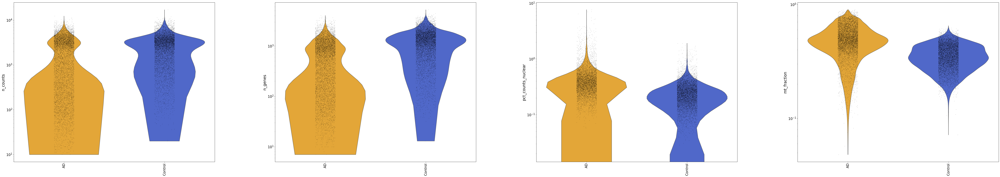

In [404]:
ax = sc.pl.violin(
    adata, 
    ['n_counts', 'n_genes', 'pct_counts_nuclear', 'mt_fraction'], 
    groupby='condition', 
    palette=adata.uns['condition_colors'], 
    size=1, log=True, rotation=90, save="_log_qc.png"
)

/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


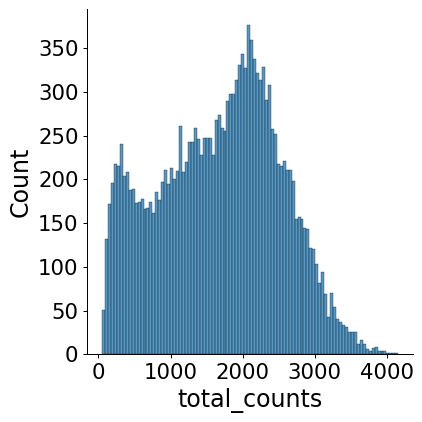

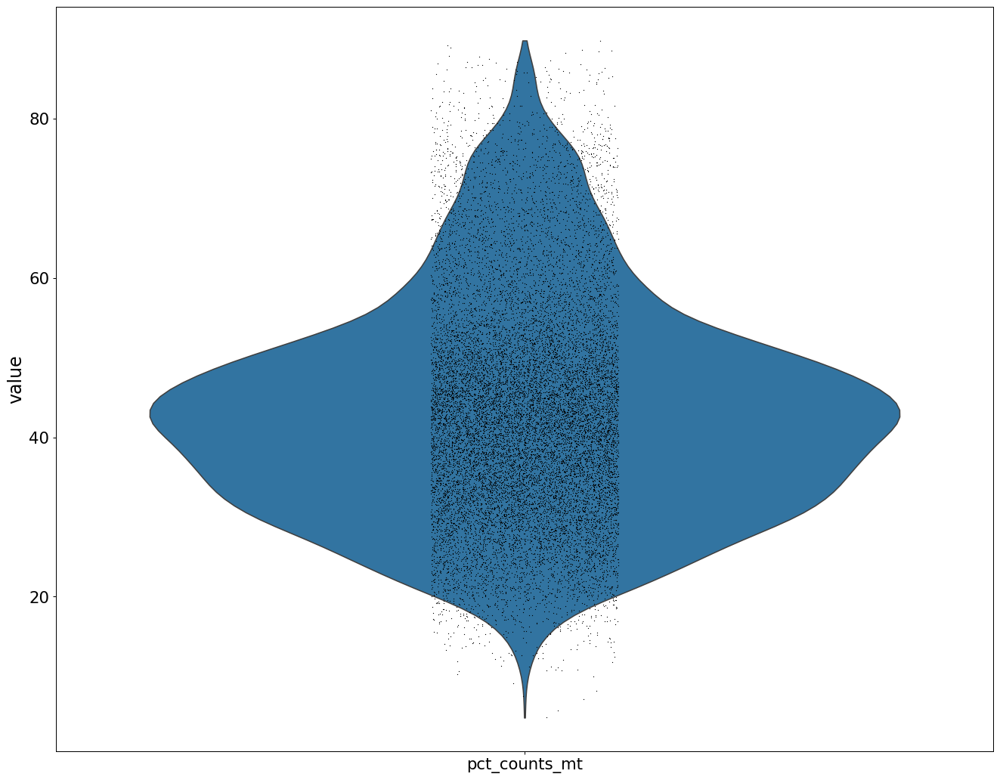

/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:315: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(adata.obs[key]):
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_utils.py:714: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color = color[sort]


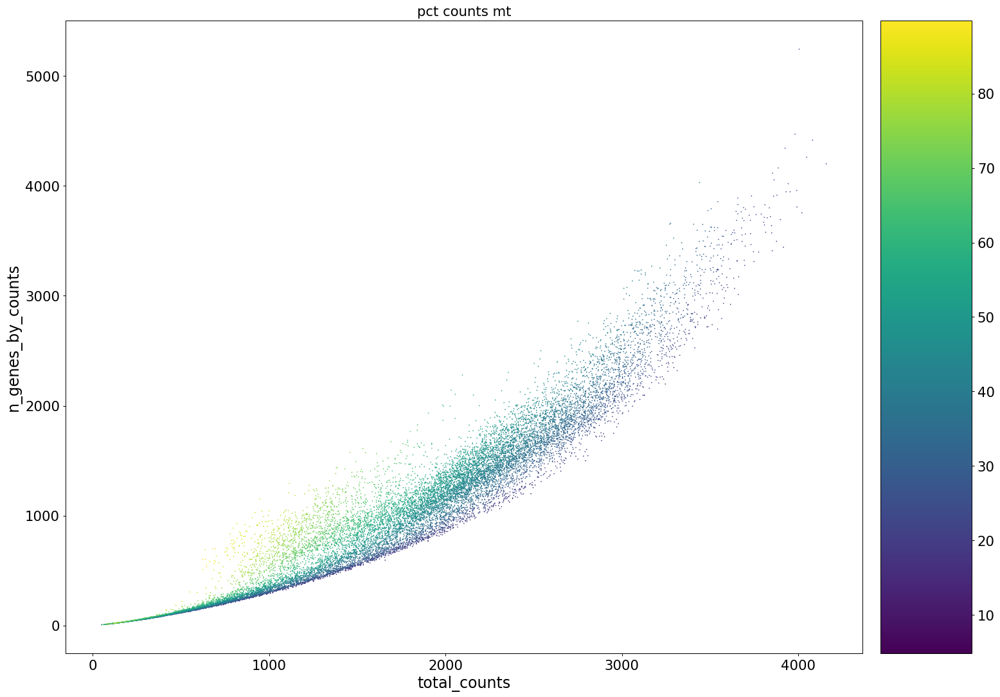

In [405]:
p1 = sns.displot(adata.obs["total_counts"], bins=100, kde=False)
# sc.pl.violin(adata, 'total_counts')
p2 = sc.pl.violin(adata, "pct_counts_mt")
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:315: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(adata.obs[key]):
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_utils.py:714: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color = color[sort]
/localscratch/fr

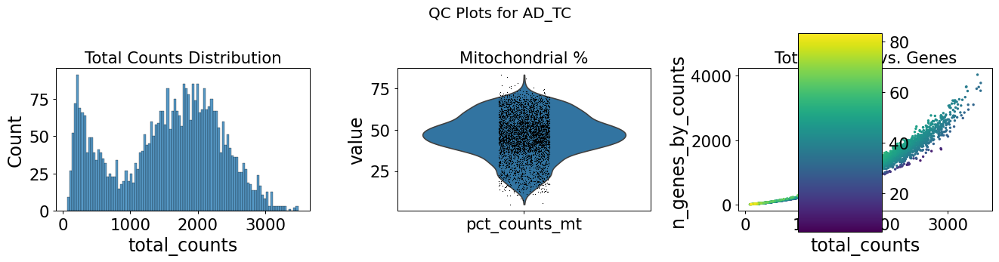

/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:315: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(adata.obs[key]):
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_utils.py:714: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color = color[sort]
/localscratch/fr

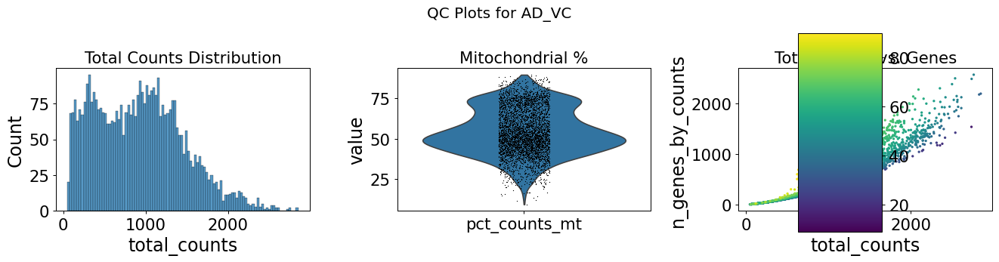

/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:315: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(adata.obs[key]):
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_utils.py:714: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color = color[sort]
/localscratch/fr

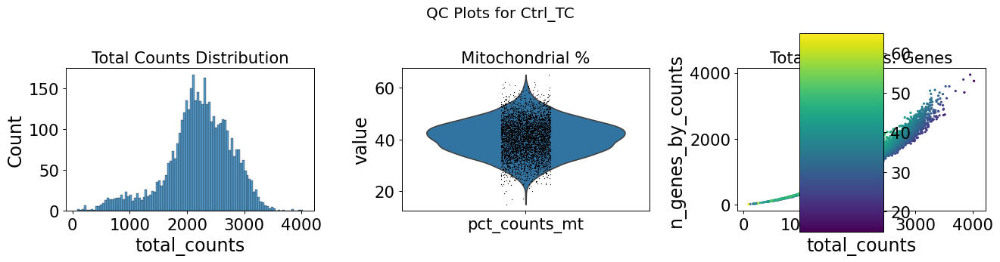

/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:842: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:315: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(adata.obs[key]):
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_utils.py:714: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color = color[sort]
/localscratch/fr

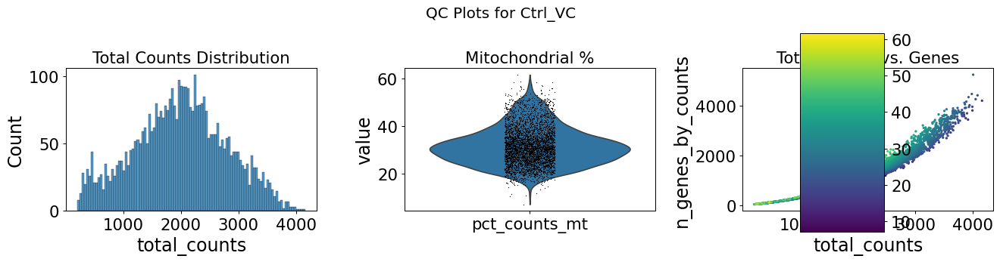

In [406]:
for cond_area in cond_area_dict.values():
    sub_adata = adata[adata.obs['cond_area'] == cond_area]

    # Create figure and axes
    fig, axes = plt.subplots(1, 3, figsize=(15, 4))
    fig.suptitle(f"QC Plots for {cond_area}", fontsize=16)

    # Histogram with seaborn on ax[0]
    sns.histplot(sub_adata.obs["total_counts"], bins=100, ax=axes[0])
    axes[0].set_title("Total Counts Distribution")

    # Violin plot on ax[1]
    sc.pl.violin(sub_adata, "pct_counts_mt", ax=axes[1], show=False)
    axes[1].set_title("Mitochondrial %")

    # Scatter plot on ax[2]
    sc.pl.scatter(sub_adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt", ax=axes[2], show=False)
    axes[2].set_title("Total Counts vs. Genes")

    plt.tight_layout()
    plt.show()

Conclusion:

- Gaussian distribution of counts for control; higher low counts for AD (Why? Is it harder to prepare AD slides?)

In [407]:
def is_outlier(adata, metric: str, nmads: int):
    M = adata.obs[metric]
    outlier = (M < np.median(M) - nmads * median_abs_deviation(M)) | (
        np.median(M) + nmads * median_abs_deviation(M) < M
    )
    return outlier

In [408]:
adata.obs["log1p_total_counts_mt"].max()

9.093582

In [412]:
import numpy as np
import pandas as pd

# Initialize empty Series to hold the final outlier mask for all cells
global_outlier_mask = pd.Series(False, index=adata.obs_names)
global_mt_outlier_mask = pd.Series(False, index=adata.obs_names)

for img in IMAGES:
    print(img)
    # Subset to current image
    img_cells = adata.obs[adata.obs["image"] == img]
    img_idx = img_cells.index
    
    # Compute outliers within the image
    is_outlier_mask = (
        is_outlier(adata[img_idx], "log1p_total_counts", 5)
        | is_outlier(adata[img_idx], "log1p_n_genes_by_counts", 5)
        | is_outlier(adata[img_idx], "pct_counts_in_top_20_genes", 5)
    )
    mt_outlier_mask = is_outlier(adata[img_idx], "pct_counts_mt", 5)  

    print(is_outlier_mask.sum(), mt_outlier_mask.sum())

    # Store in the global mask
    global_outlier_mask.loc[img_idx] = is_outlier_mask
    global_mt_outlier_mask.loc[img_idx] = mt_outlier_mask

# Store in adata.obs
adata.obs["outlier"] = global_outlier_mask
adata.obs["mt_outlier"] = global_mt_outlier_mask

# Optional: check counts
print(adata.obs["outlier"].value_counts())
print(adata.obs["mt_outlier"].value_counts())


A1
866 0
B1
0 0
C1
366 2
D1
49 10
outlier
False    15871
True      1281
Name: count, dtype: int64
mt_outlier
False    17140
True        12
Name: count, dtype: int64


In [413]:
print(f"Total number of cells: {adata.n_obs}")
adata_filtered = adata[(~adata.obs.outlier) & (~adata.obs.mt_outlier)].copy()

print(f"Number of cells after filtering of low quality cells: {adata.n_obs}")

Total number of cells: 17152
Number of cells after filtering of low quality cells: 15865


In [414]:
condition_abbrev = {
    'Control': 'Ctrl',
    'AD': 'AD',
}

adata_filtered.obs['condition'] = adata_filtered.obs['condition'].map(condition_abbrev)
adata_filtered.obs['condition_area'] = adata_filtered.obs['condition'].astype(str) + '_' + adata_filtered.obs['area'].astype(str)
np.unique(adata_filtered.obs['condition_area'])

array(['AD_TC', 'AD_VC', 'Ctrl_TC', 'Ctrl_VC'], dtype=object)

In [415]:
n_genes_threshold = {
    'AD_PFC': (400, 9000), 
    'AD_TC': (350, 7000),
    'AD_VC': (350, 8000),
    'Ctrl_PFC': (410, 10000),
    'Ctrl_TC': (410, 9500),
    'Ctrl_VC': (400, 10000)
}
n_counts_threshold = {
    'AD_PFC': (500, 50000), 
    'AD_TC': (500, 30000),
    'AD_VC': (500, 40000),
    'Ctrl_PFC': (500, 60000),
    'Ctrl_TC': (500, 60000),
    'Ctrl_VC': (500, 60000)
}
mt_threshold = {
    'AD_PFC': 0.1, 
    'AD_TC': 0.2,
    'AD_VC': 0.25,
    'Ctrl_PFC': 0.1,
    'Ctrl_TC': 0.1,
    'Ctrl_VC': 0.17
}
malat1_threshold = {
    'AD_PFC': 1, 
    'AD_TC': 0.8,
    'AD_VC': 0.8,
    'Ctrl_PFC': 1,
    'Ctrl_TC': 0.8,
    'Ctrl_VC': 0.8
}

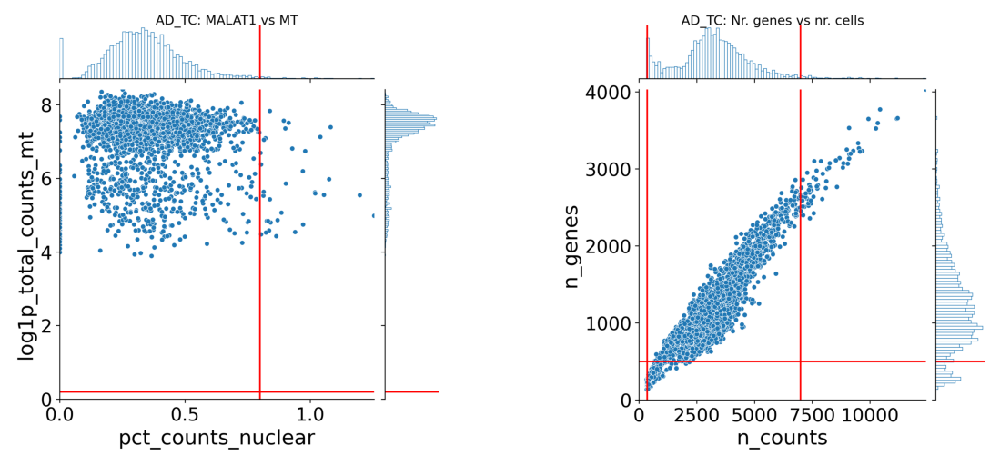

<Figure size 1260x1350 with 0 Axes>

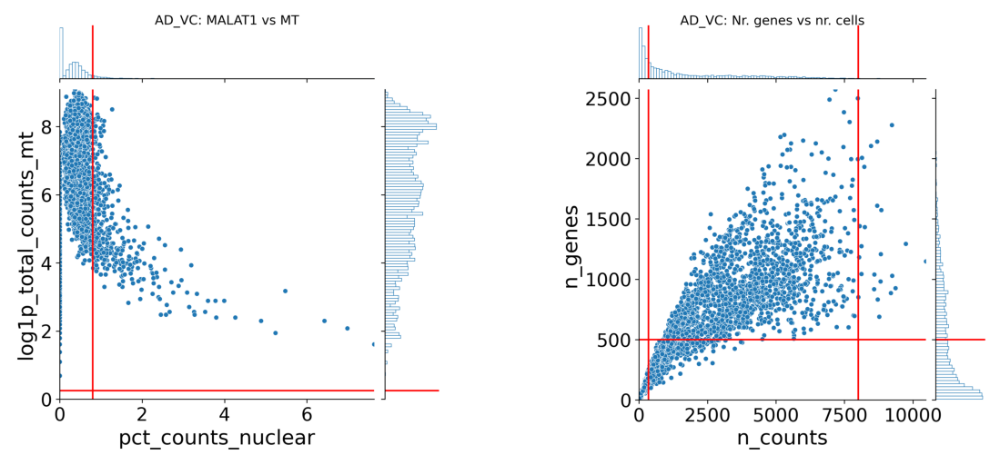

<Figure size 1260x1350 with 0 Axes>

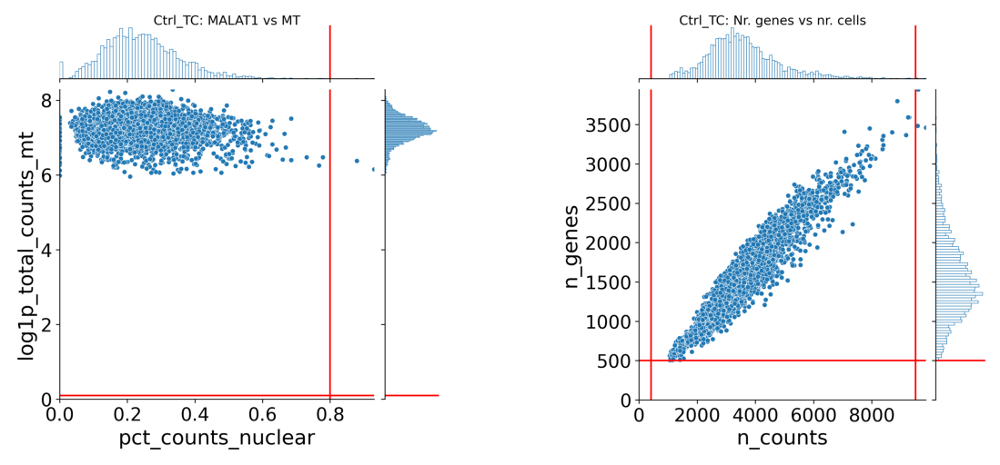

<Figure size 1260x1350 with 0 Axes>

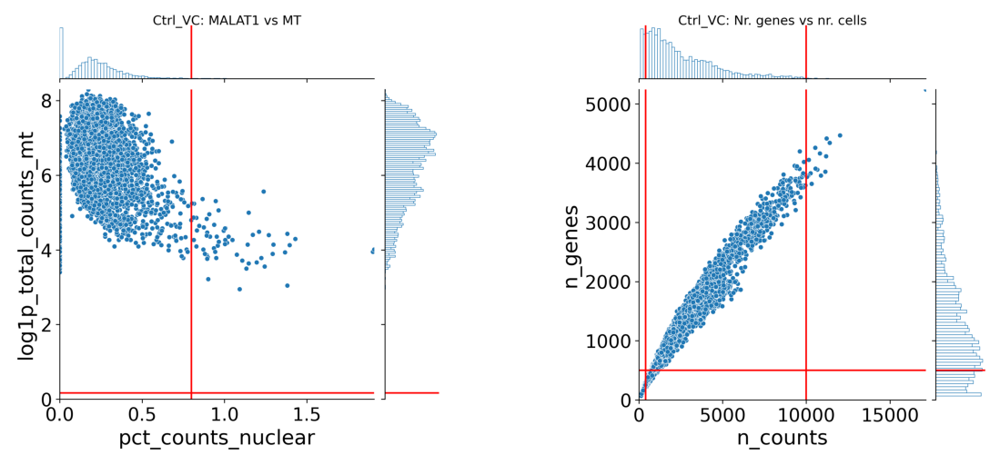

<Figure size 1260x1350 with 0 Axes>

In [416]:
for i, obs_name in enumerate(np.unique(adata.obs['condition_area'])):
    sub_adata = adata_filtered[adata_filtered.obs['condition_area'] == obs_name]
    df = sub_adata.obs[["log_counts", "log1p_total_counts_mt", "pct_counts_nuclear", "n_genes", "n_counts"]].copy()
    g1 = plot_qc_joint(
        df=df,
        x="pct_counts_nuclear",
        y="log1p_total_counts_mt",
        log_x=1,
        x_threshold=(0, malat1_threshold[obs_name]),
        y_threshold = (mt_threshold[obs_name], np.inf),
        title=f"{obs_name}: MALAT1 vs MT",
        s=20,
        show = False
    )
    g2 = plot_qc_joint(
        df=df,
        x="n_counts",
        y="n_genes",
        log_x=1,
        log_y=1,
        x_threshold = (n_genes_threshold[obs_name][0], n_genes_threshold[obs_name][1]),
        y_threshold = (n_counts_threshold[obs_name][0], n_counts_threshold[obs_name][1]),
        title=f"{obs_name}: Nr. genes vs nr. cells",
        s=20,
        show = False
    )
    
    # Save both plots
    g1.fig.savefig(f"{FIG_DIR}/{obs_name}_MALAT1_MT_filtered.png", bbox_inches='tight')
    g2.fig.savefig(f"{FIG_DIR}/{obs_name}_genes_counts_filtered1.png", bbox_inches='tight')
    
    # Now combine both into one figure
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    img1 = plt.imread(f"{FIG_DIR}/{obs_name}_MALAT1_MT_filtered.png")
    img2 = plt.imread(f"{FIG_DIR}/{obs_name}_genes_counts_filtered1.png")
    
    axs[0].imshow(img1)
    axs[0].axis("off")
    axs[1].imshow(img2)
    axs[1].axis("off")
    plt.tight_layout()
    plt.show()
    plt.savefig(f"{FIG_DIR}/joint_qc_{obs_name}_malat1_mt.png")
    plt.rcParams['figure.figsize']= (14, 15)

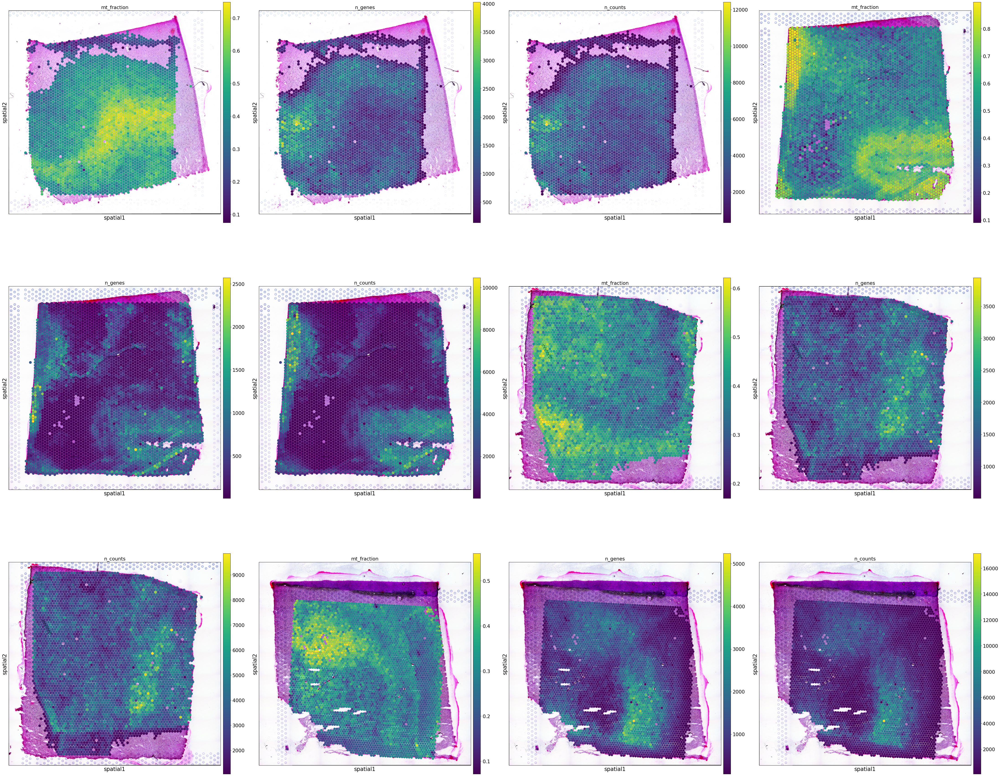

In [424]:
sq.pl.spatial_scatter(
    adata_filtered,
    library_key = 'image',
    color=['mt_fraction', 'n_genes', 'n_counts'],
    size=1.5,
    legend_loc="right",  
    save = f'spatial_qc_filtered.png'
)

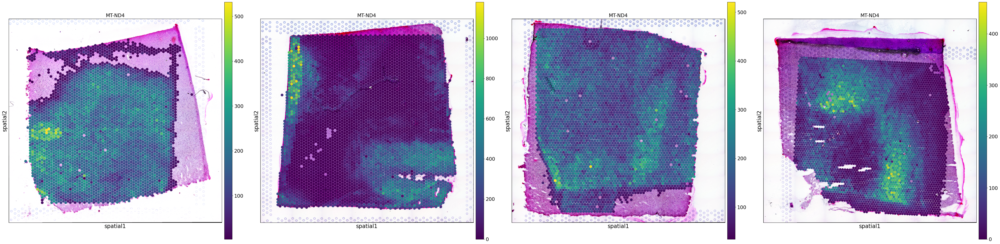

In [425]:
sq.pl.spatial_scatter(
    adata,
    library_key = 'image',
    color=['MT-ND4'],
    size=1.5,
    legend_loc="right",  
    save = f'spatial_MT-ND4.png'
)

In [426]:
#amyloid_plaque_human = [Axl, C1qc, Clu, Cst3, Ctsh, Cyba, Gfap, Grn, Hexb, Igfbp5, Laptm5, 'LY86', 'LYZ', 'OLFML3', 'TYROBP']
amyloid_plaque_human = ['LY86', 'TYROBP']

## QC by clustering

This is not needed if no statistical testing will be performed.

In [51]:
#adata.var["highly_variable"] = adata.var["highly_deviant"]
sc.pp.highly_variable_genes(adata, flavor='cell_ranger', batch_key = 'cond_area')

extracting highly variable genes


/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:247: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:247: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/preprocessing/_h

    finished (0:00:02)


In [52]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


In [53]:
adata.layers["log1p_norm"] = adata.X
adata.obs['log1p_counts'] = adata.layers["log1p_norm"].sum(1)

In [54]:
sc.tl.pca(adata, use_highly_variable = True)
sc.pp.neighbors(adata)
sc.tl.leiden(adata)
sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:30)
running Leiden clustering
    finished (0:00:07)
computing UMAP
    finished (0:00:10)


In [55]:
# TODO: Change color mapping

/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/ictstr01/groups/ml01/workspace/francesca.drummer/mamba/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter

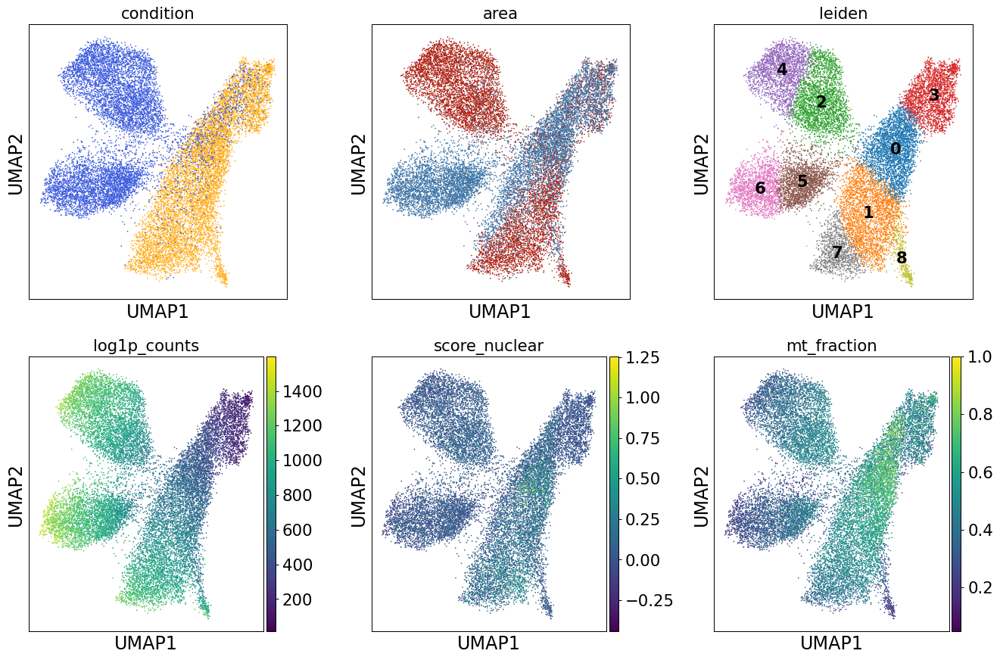

In [56]:
import matplotlib.pyplot as plt
import scanpy as sc

# Create subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))
plt.rcParams['figure.figsize']= (6, 6)
axs = axs.flatten()

# Plot UMAPs without legends
sc.pl.umap(adata, color='condition', ax=axs[0], show=False, legend_loc=None)
sc.pl.umap(adata, color='area', ax=axs[1], show=False, legend_loc=None)
sc.pl.umap(adata, color='leiden', ax=axs[2], show=False, legend_loc='on data')
sc.pl.umap(adata, color='log1p_counts', ax=axs[3], show=False, legend_loc=None)
sc.pl.umap(adata, color='score_nuclear', ax=axs[4], show=False, legend_loc=None)
sc.pl.umap(adata, color='mt_fraction', ax=axs[5], show=False, legend_loc=None)

plt.tight_layout()
plt.savefig(f"{FIG_DIR}/qc_combined_umap_subplots_no_legend.png")  # Optional
plt.show()

In [65]:
filtered_adata = adata[~adata.obs['leiden'].isin(['0','3'])]
filtered_adata

View of AnnData object with n_obs × n_vars = 12005 × 18415
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'cond_area', 'area', 'condition', 'n_counts', 'log_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'malat1_log', 'mt_fraction', 'total_counts_nuclear', 'pct_counts_nuclear', 'score_nuclear', 'area_abbrev', 'condition_area', 'log1p_counts', 'leiden'
    var: 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'nuclear', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'condition_colors', 'log1p', 'hvg', 'pca', 'neighbo

In [66]:
print(f'{len(adata.obs_names) - len(filtered_adata.obs_names)} spots removed')

5164 cells removed


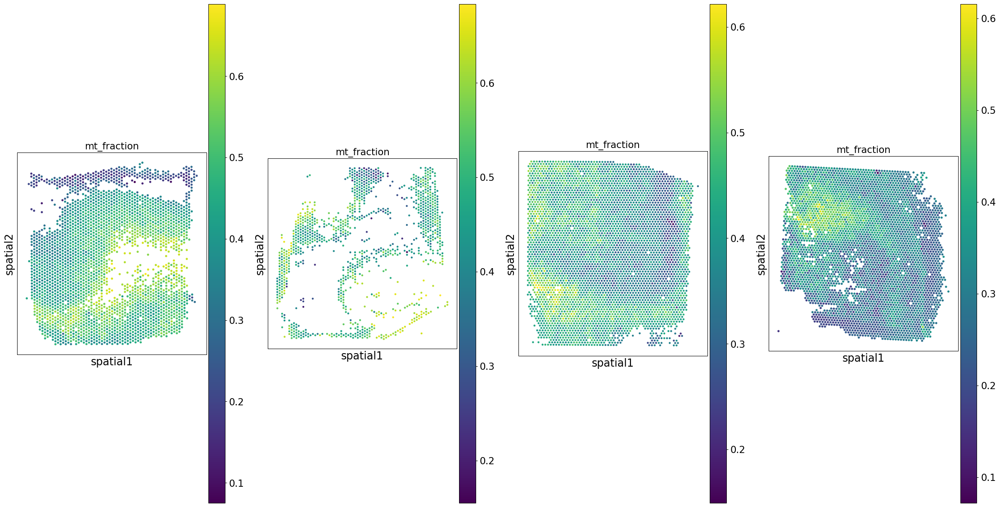

In [82]:
fig, axs = plt.subplots(1, 4, figsize=(25, 20))

for i, library in enumerate(IMAGES):
    ad = filtered_adata[filtered_adata.obs.library_id == library].copy()
    
    sc.pl.spatial(
        ad,
        color="mt_fraction",
        size=1.5,
        legend_loc="right",  
        show=False,
        ax=axs[i],
        spot_size=80 
    )

plt.tight_layout()

If I filter according to removing spots with high MT fraction and low log1 p gene counts then I mainly remove AD spots.

# Visualization

The unfiltered data is visualized because otherwise there will be spotty patches. 

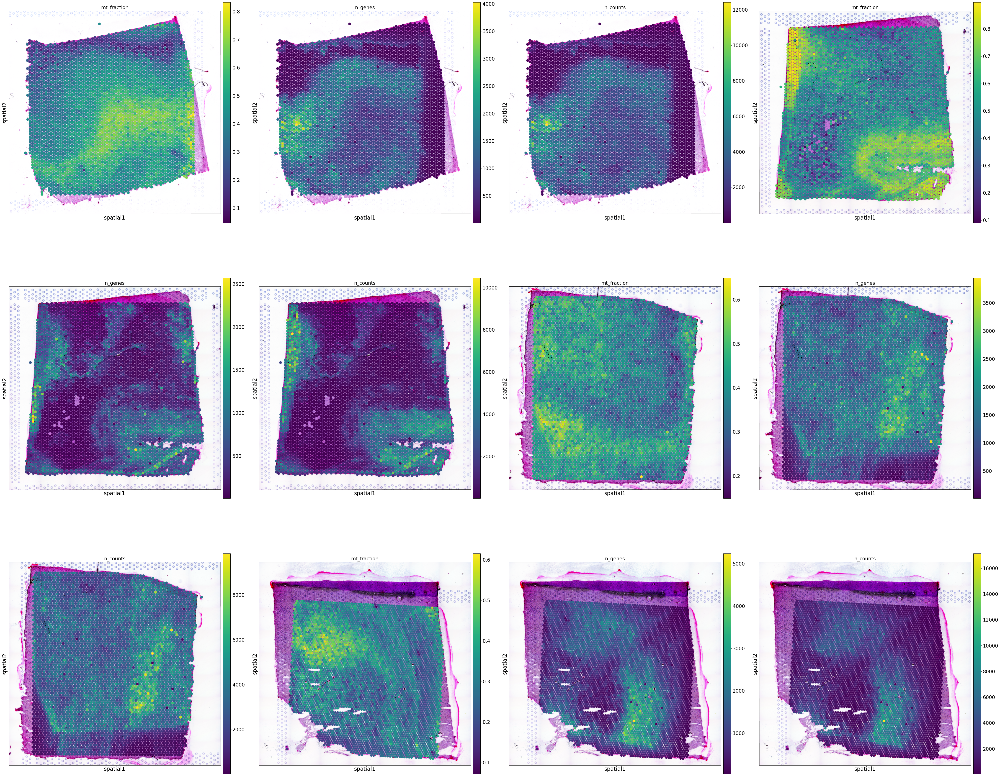

In [454]:
sq.pl.spatial_scatter(
    adata,
    library_key = 'image',
    color=['mt_fraction', 'n_genes', 'n_counts'],
    size=1.5,
    legend_loc="right",  
    save = f'spatial_qc_filtered.png'
)

In [455]:
adata.write(f'{VISIUM_DATA}/adata/adata_qc_metric.h5ad')